In [1]:
pip install pandas geopandas matplotlib

In [2]:
!pip install contextily

## Loader

In [3]:
from google.colab import files

uploaded = files.upload()

for filename in uploaded.keys():
    print('Uploaded file:', filename)

# Get the file path of the uploaded file
# file_path = list(uploaded.keys())[0]

Saving buildings.cpg to buildings (1).cpg
Saving buildings.dbf to buildings (1).dbf
Saving buildings.prj to buildings (1).prj
Saving buildings.shp to buildings (1).shp
Saving buildings.shx to buildings (1).shx
Saving landuse.cpg to landuse (1).cpg
Saving landuse.dbf to landuse (1).dbf
Saving landuse.prj to landuse (1).prj
Saving landuse.shp to landuse (1).shp
Saving landuse.shx to landuse (1).shx
Saving natural.cpg to natural (1).cpg
Saving natural.dbf to natural (1).dbf
Saving natural.prj to natural (1).prj
Saving natural.shp to natural (1).shp
Saving natural.shx to natural (1).shx
Saving places.cpg to places (1).cpg
Saving places.dbf to places (1).dbf
Saving places.prj to places (1).prj
Saving places.shp to places (1).shp
Saving places.shx to places (1).shx
Saving points.cpg to points (1).cpg
Saving points.dbf to points (1).dbf
Saving points.prj to points (1).prj
Saving points.shp to points (1).shp
Saving points.shx to points (1).shx
Saving railways.cpg to railways (1).cpg
Saving rai

In [4]:
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx

# Load each shapefile
buildings = gpd.read_file('buildings.shp')
landuse = gpd.read_file('landuse.shp')
natural = gpd.read_file('natural.shp')
places = gpd.read_file('places.shp')
points = gpd.read_file('points.shp')
railways = gpd.read_file('railways.shp')
roads = gpd.read_file('roads.shp')
waterways = gpd.read_file('waterways.shp')

In [5]:
#buildings

In [6]:
#landuse

In [7]:
#natural

In [8]:
#places

In [9]:
#points

In [10]:
#railways

In [11]:
#roads

In [12]:
#waterways

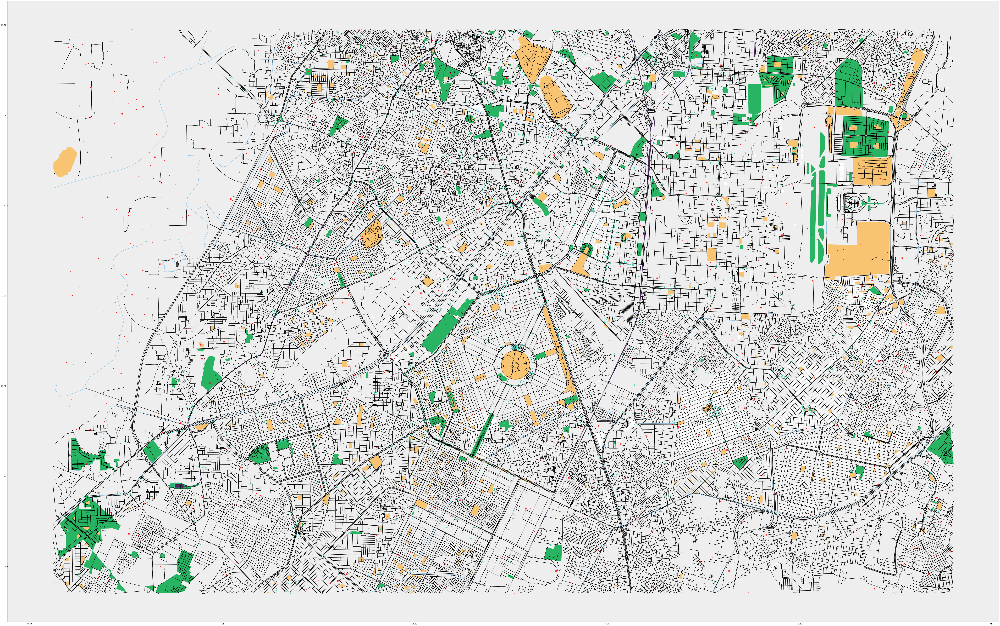

In [14]:
import numpy as np

# Plot each layer
fig, ax = plt.subplots(figsize=(100, 100))

# Set background color
ax.set_facecolor('#EEEEEE')  # Set to light gray, you can use any color you want

buildings.plot(ax=ax, color='#FFFFFF')
landuse.plot(ax=ax, color='#28B463')
natural.plot(ax=ax, color='#F8C471')
places.plot(ax=ax, color='#99A3A4')
points.plot(ax=ax, color='#48C9B0')
railways.plot(ax=ax, color='#4A235A')
roads.plot(ax=ax, color='#000000')
waterways.plot(ax=ax, color='#85C1E9')

# Get the bounding box of the GeoDataFrame
minx, miny, maxx, maxy = buildings.total_bounds

# Print the bounding box to verify values
# print("Bounding box:", minx, miny, maxx, maxy)

# Generate random coordinates within the bounding box of your data
num_points = 1000  # Number of random points to generate
random_x = np.random.uniform(minx, maxx, num_points)
random_y = np.random.uniform(miny, maxy, num_points)

# Plot the random points
ax.scatter(random_x, random_y, color='red', marker='x', label='Random Points')

# Show the plot
plt.show()

In [15]:
city_zones = buildings

In [16]:
#TO DO
# Can use implementation done in previous lab

### Help Codes for referance

<ipython-input-17-02407dbbb6b1>:53: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(ScalarMappable(norm=norm, cmap=cmap), label='Intensity')


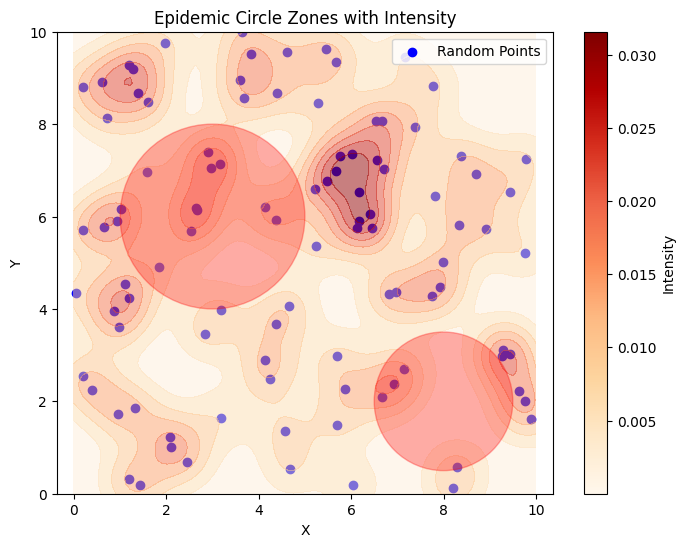

In [17]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.neighbors import KernelDensity
from matplotlib.colors import Normalize
from matplotlib.cm import ScalarMappable

# Generate random points
np.random.seed(0)
num_points = 100
points_x = np.random.uniform(low=0, high=10, size=num_points)
points_y = np.random.uniform(low=0, high=10, size=num_points)

# Plot random points
plt.figure(figsize=(8, 6))
plt.scatter(points_x, points_y, color='blue', label='Random Points')

# Simulate epidemic circles
epidemic_centers = [(3, 6), (8, 2)]  # Coordinates of epidemic centers
epidemic_radii = [2, 1.5]  # Radii of epidemic circles

# Create labels for points (0 for outside the circles, 1 for inside)
labels = np.zeros(num_points)
for i, (x, y) in enumerate(zip(points_x, points_y)):
    for center, radius in zip(epidemic_centers, epidemic_radii):
        if (x - center[0])**2 + (y - center[1])**2 <= radius**2:
            labels[i] = 1
            break

# Use Kernel Density Estimation (KDE) to estimate intensity of zones
X = np.column_stack((points_x, points_y))
kde = KernelDensity(bandwidth=0.5, kernel='gaussian')
kde.fit(X)

# Create grid for heatmap
x_grid, y_grid = np.meshgrid(np.linspace(0, 10, 100), np.linspace(0, 10, 100))
grid_points = np.vstack([x_grid.ravel(), y_grid.ravel()]).T
densities = np.exp(kde.score_samples(grid_points))
densities = densities.reshape(x_grid.shape)

# Plot heatmap
cmap = plt.cm.OrRd  # Choose colormap
norm = Normalize(vmin=densities.min(), vmax=densities.max())
plt.contourf(x_grid, y_grid, densities, cmap=cmap, norm=norm, alpha=0.5)

# Plot epidemic circles
for center, radius in zip(epidemic_centers, epidemic_radii):
    circle = plt.Circle(center, radius, color='red', alpha=0.3)
    plt.gca().add_patch(circle)

plt.xlabel('X')
plt.ylabel('Y')
plt.title('Epidemic Circle Zones with Intensity')
plt.colorbar(ScalarMappable(norm=norm, cmap=cmap), label='Intensity')
plt.legend()
plt.axis('equal')
plt.show()


<ipython-input-18-d3da877450f0>:28: RuntimeWarning: invalid value encountered in scalar divide
  circle = plt.Circle((x, y), epidemic_radii[i], color=cm.Blues(epidemic_radii[i] / np.max(epidemic_radii)), alpha=0.5)


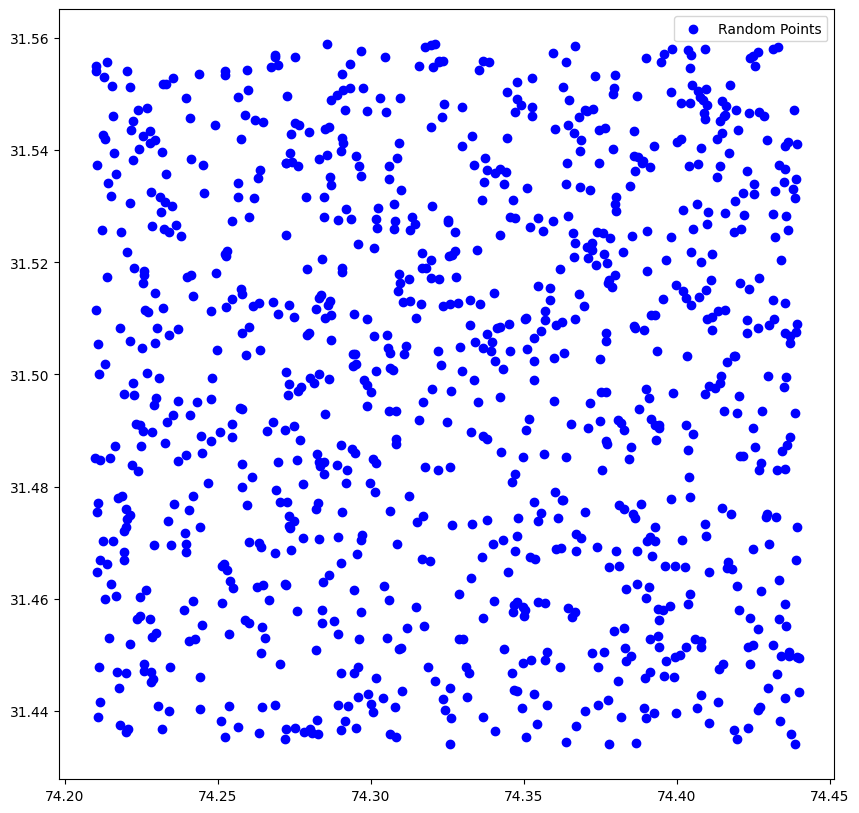

In [18]:
from sklearn.neighbors import NearestNeighbors
import matplotlib.cm as cm

# Combine random_x and random_y into a single array
random_points = np.column_stack((random_x, random_y))

# Define the number of nearest neighbors for the KNN model
k = 1

# Create and fit KNN model
knn_model = NearestNeighbors(n_neighbors=k)
knn_model.fit(random_points)

# Find nearest neighbors and distances for each point
distances, indices = knn_model.kneighbors(random_points)

# Calculate radius based on the distance to the nearest neighbor
epidemic_radii = distances.flatten()

# Plot circles representing epidemic centers with color intensity dependent on radius
fig, ax = plt.subplots(figsize=(10, 10))

# Plot random points
ax.scatter(random_x, random_y, color='blue', label='Random Points')

# Plot circles representing epidemic centers with color intensity dependent on radius
for i, (x, y) in enumerate(random_points):
    circle = plt.Circle((x, y), epidemic_radii[i], color=cm.Blues(epidemic_radii[i] / np.max(epidemic_radii)), alpha=0.5)
    ax.add_artist(circle)

# Add legend
ax.legend()

# Show the plot
plt.show()
